## **Применение метода «скользящего окна» для фильтрации изображений и поиска объектов на изображении по эталонам в среде Python**





In [21]:
!pip install numpy

In [22]:
!pip install opencv-python

In [23]:
from google.colab import drive
drive.mount('/content/hw2', force_remount=True)

Mounted at /content/hw2


In [24]:
!ls /content/hw2/"My Drive"/"package_for_python"/"noise"/

shell-init: error retrieving current directory: getcwd: cannot access parent directories: Transport endpoint is not connected
image1.jpg  image2.jpg	image3.jpg  image4.jpg	image5.jpg


## **Медианный фильтр**

In [25]:
import cv2
import argparse
import os
import numpy as np

In [26]:
from google.colab.patches import cv2_imshow

In [27]:
image_directory = '/content/hw2/My Drive/package_for_python/noise'
image_files = [f for f in os.listdir(image_directory) if os.path.isfile(os.path.join(image_directory, f))]


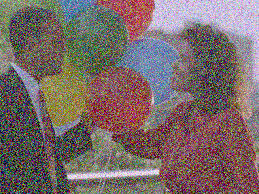

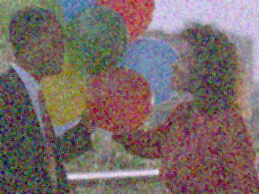

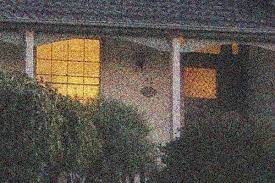

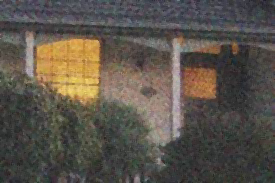

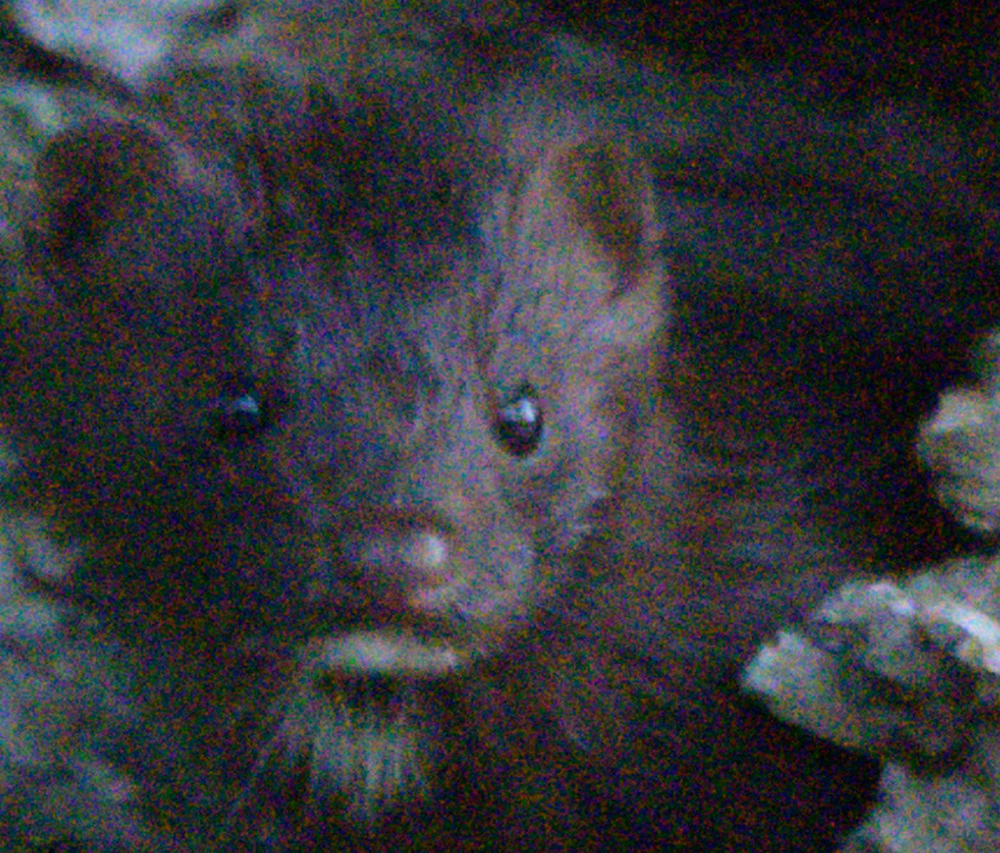

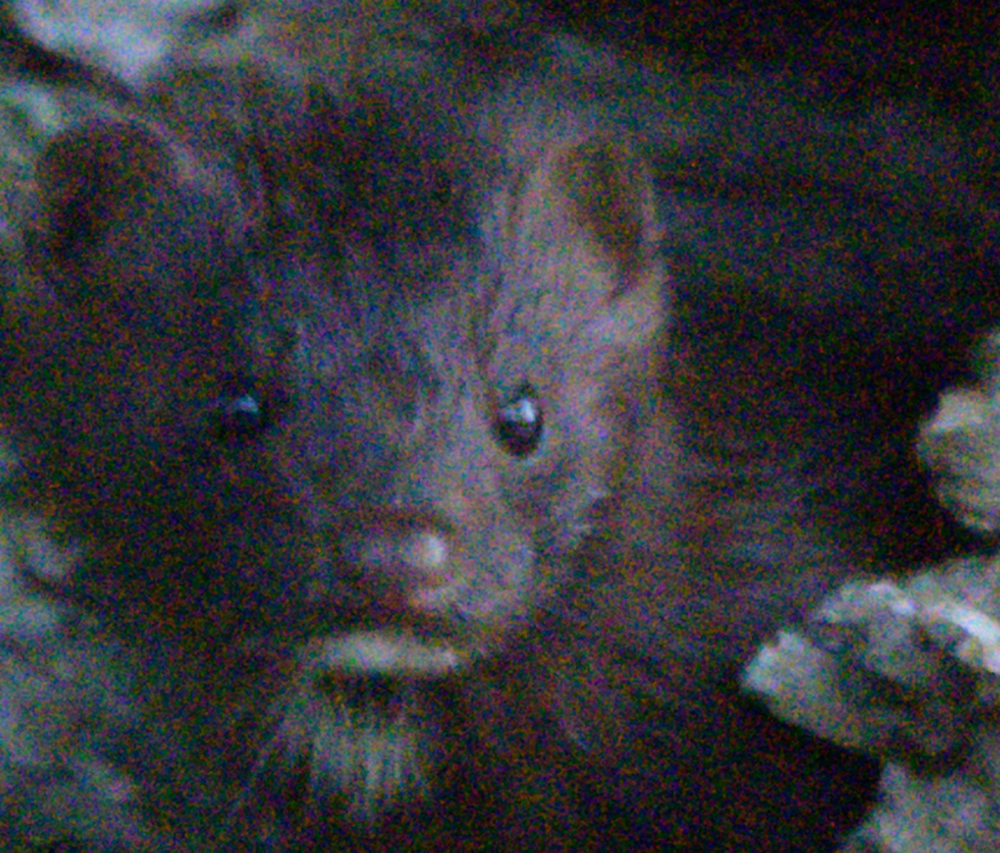

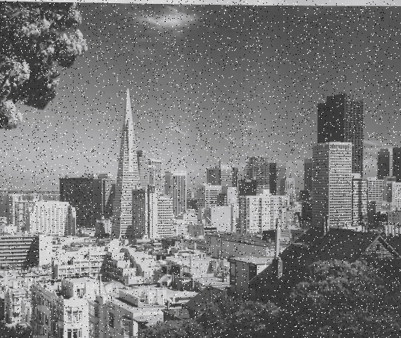

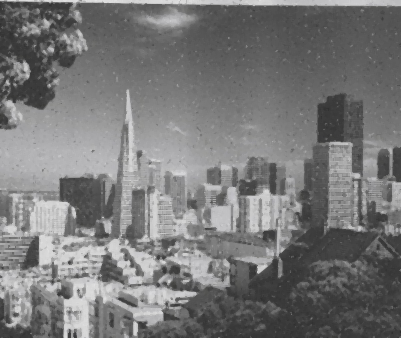

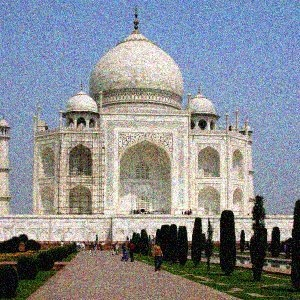

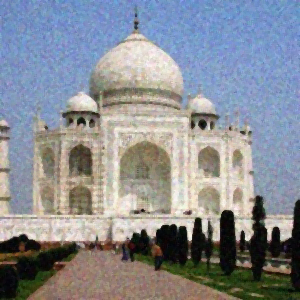

In [28]:
for image_file in image_files:
    image_path = os.path.join(image_directory, image_file)
    image = cv2.imread(image_path)
    processed_image = cv2.medianBlur(image, 3)
    cv2_imshow(image)
    processed_image_with_title = processed_image.copy()
    cv2_imshow(processed_image_with_title)
    output_file = os.path.splitext(image_file)[0] + '_processed.png'
    cv2.imwrite(output_file, processed_image)

## **Средний фильтр**

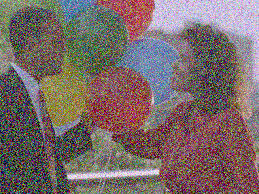

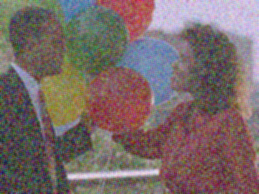

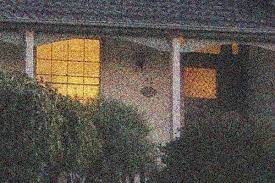

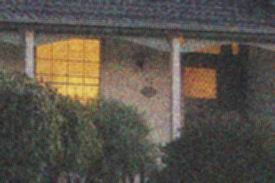

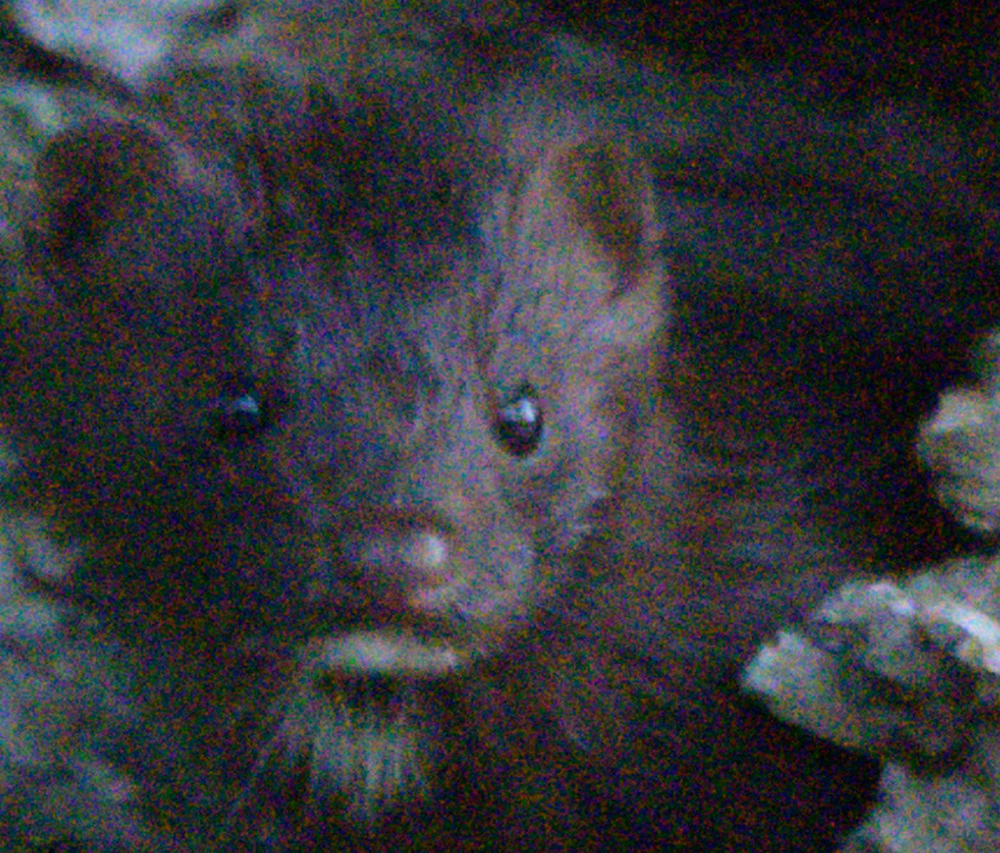

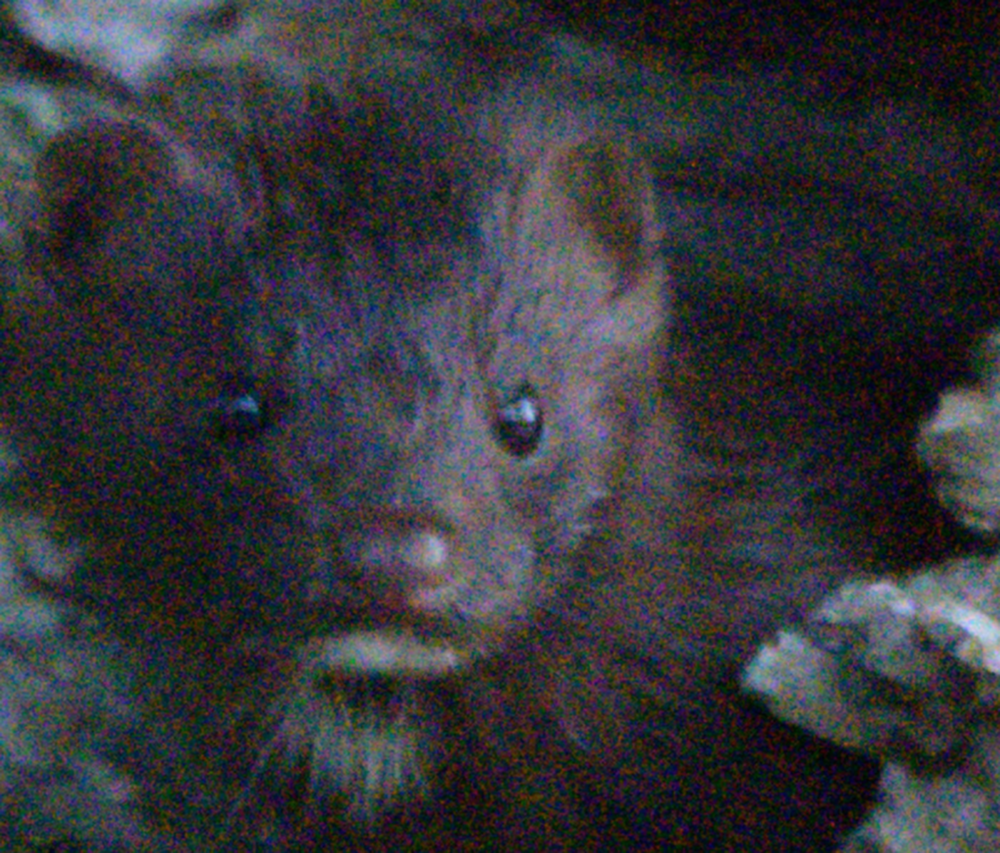

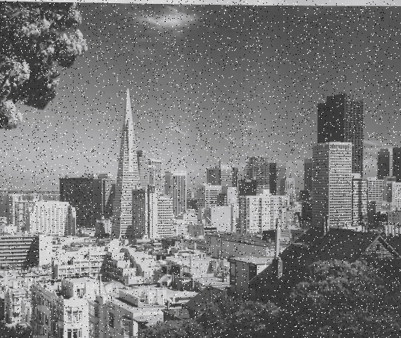

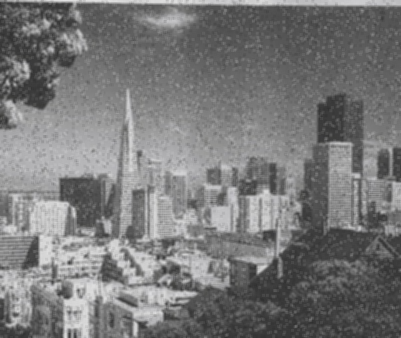

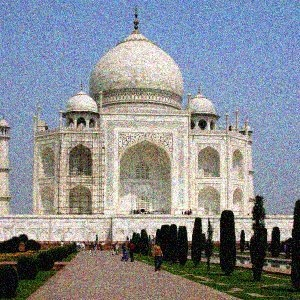

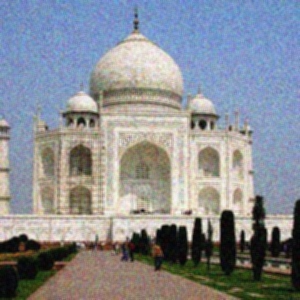

In [29]:
for image_file in image_files:
    image_path = os.path.join(image_directory, image_file)
    image = cv2.imread(image_path)
    kernel = np.ones((3,3),np.float32)/9
    processed_image = cv2.filter2D(image,-1,kernel)
    cv2_imshow(image)
    processed_image_with_title = processed_image.copy()
    cv2_imshow(processed_image_with_title)
    output_file = os.path.splitext(image_file)[0] + '_processed.png'
    cv2.imwrite(output_file, processed_image)

## **2. Из подкаталога «Image_1» (каталога IMAGE), определить местонахождение всех фрагментов (Et_1.png - Et_10.png) на растре IMAGE.jpg, используя вышеописанный алгоритм. Сделать скриншоты с результатами по каждому эталону**

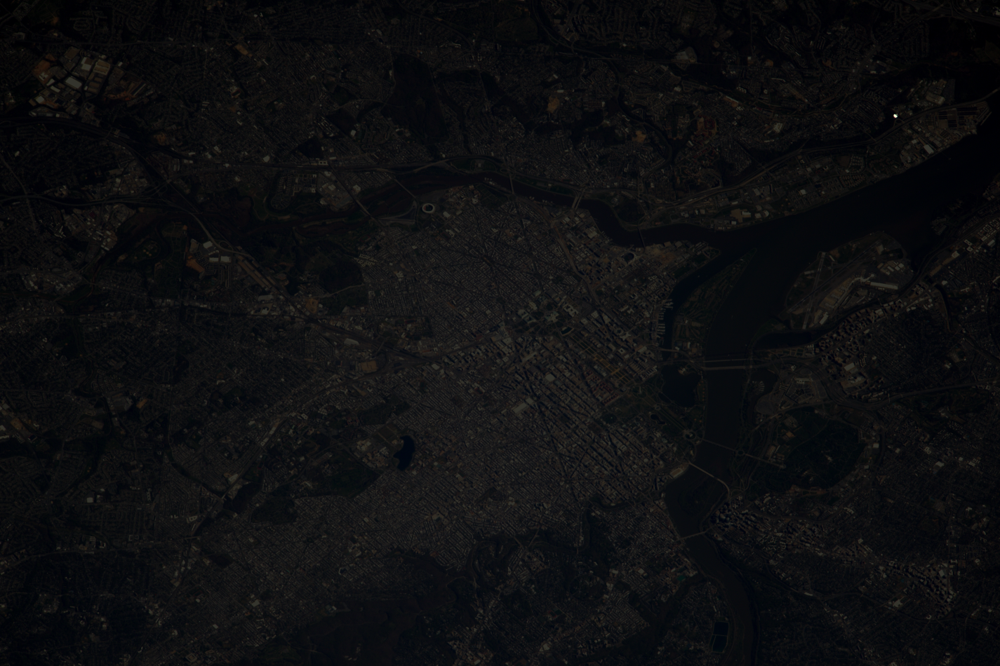

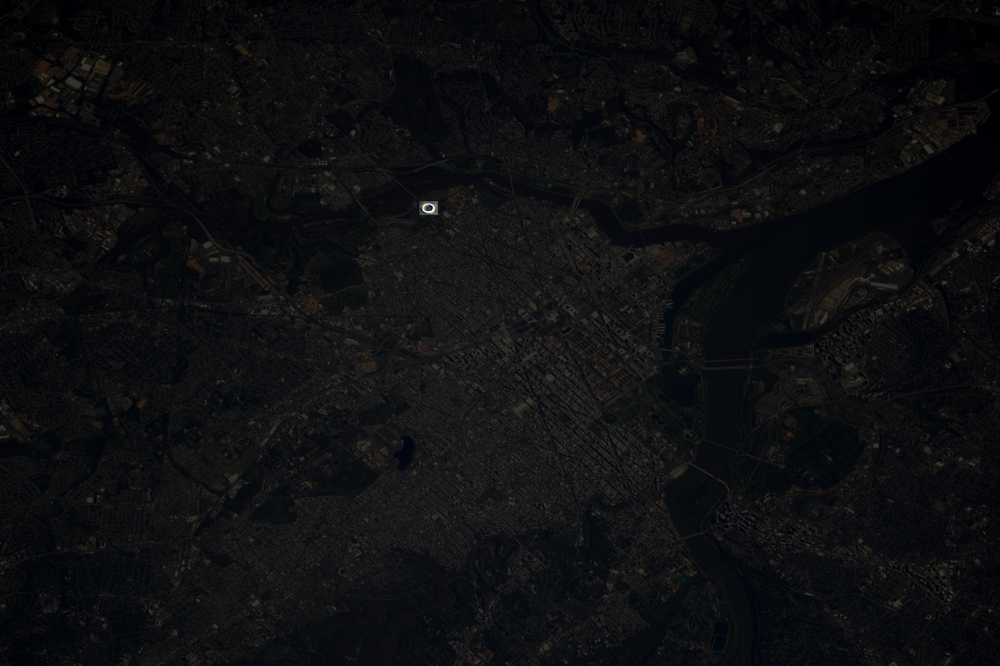

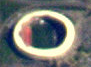

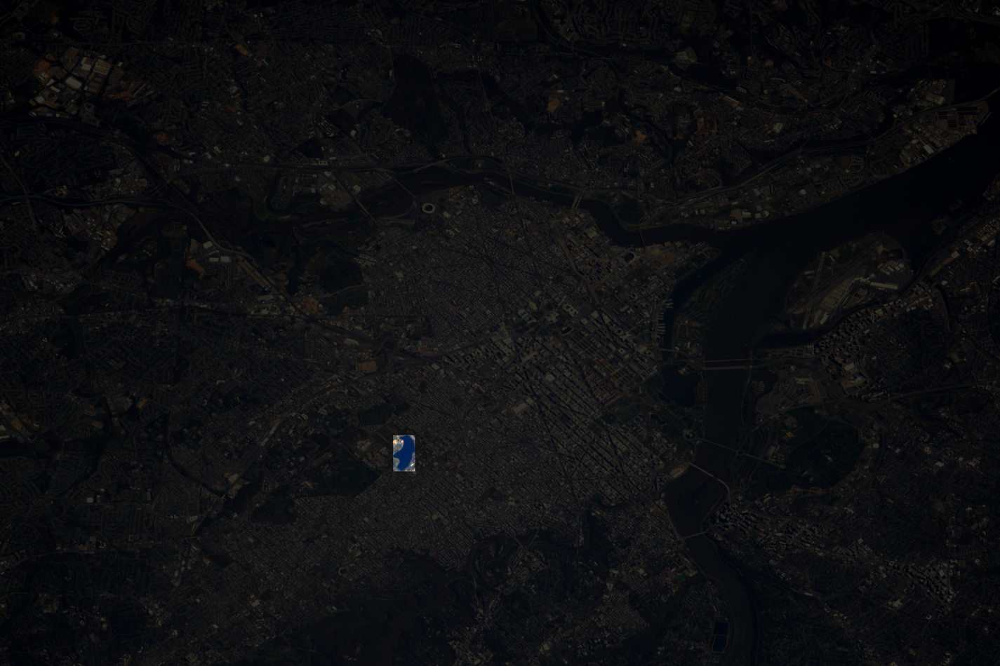

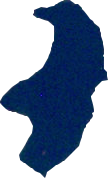

...

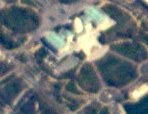

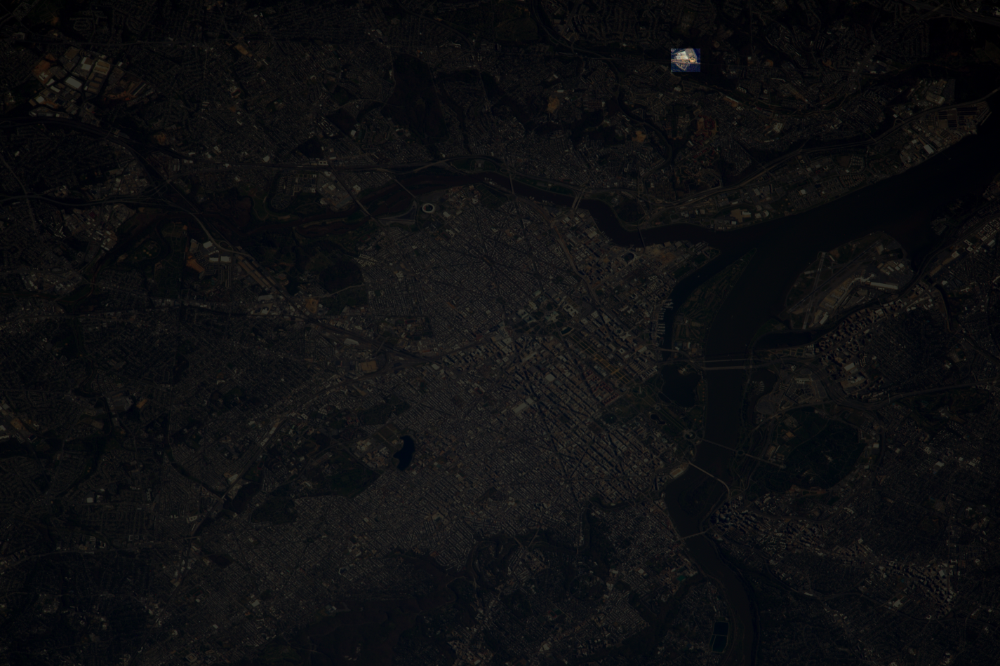

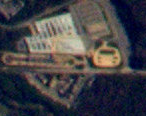

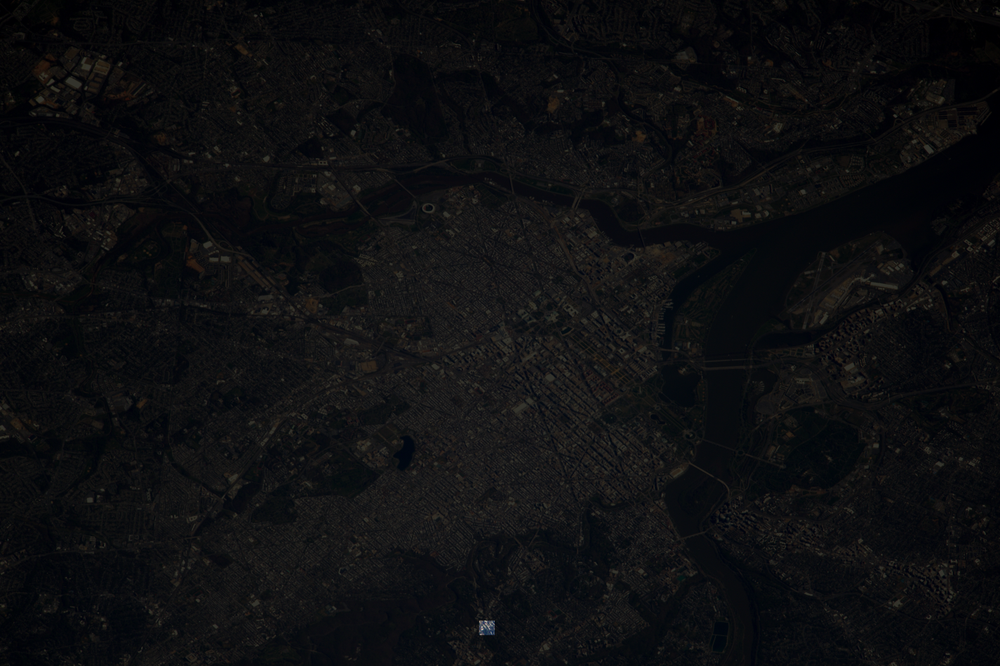

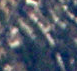

In [30]:
import os, cv2, argparse, imutils, copy
import numpy as np
from google.colab.patches import cv2_imshow

os.chdir('/content/hw2/MyDrive/package_for_python/IMAGE/Image_1')
image_main = cv2.imread('IMAGE.jpg')

for i in range(10):
  image = image_main.copy()
  fragment = cv2.imread(f'Et_{i+1}.png')
  (fragmentHeight, fragmentWidth) = fragment.shape[:2]
  result = cv2.matchTemplate(image, fragment, cv2.TM_CCOEFF)
  (_, _, minLoc, maxLoc) = cv2.minMaxLoc(result)

  topLeft = maxLoc
  botRight = (topLeft[0] + fragmentWidth, topLeft[1] + fragmentHeight)
  roi = image[topLeft[1]:botRight[1], topLeft[0]:botRight[0]]

  mask = np.zeros(image.shape, dtype="uint8")
  image = cv2.addWeighted(image, 0.20, mask, 0.75, 0)

  image[topLeft[1]:botRight[1], topLeft[0]:botRight[0]] = roi


  cv2_imshow(imutils.resize(image, height=950))
  cv2_imshow(fragment)

## **3. Создать свой эталон (фрагмент), а затем определить его местонахождение на растре (по образцу из примера выше). Главное при создании фрагмента учесть его разрешение.**

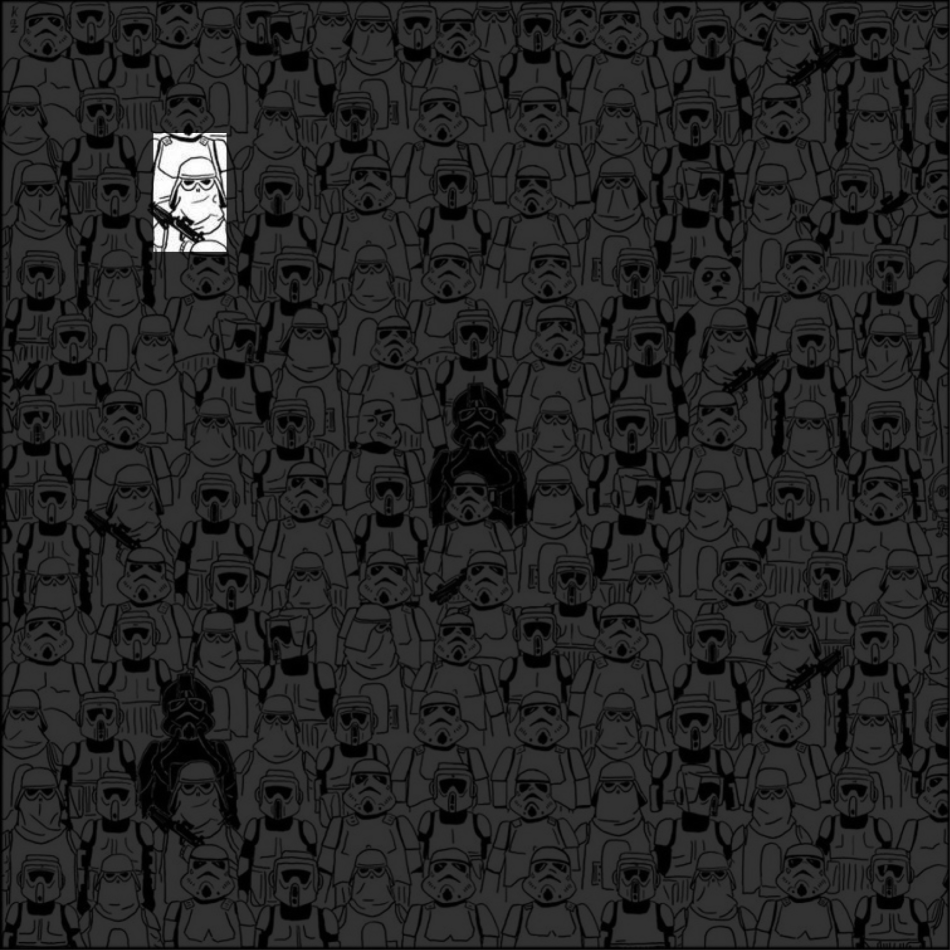

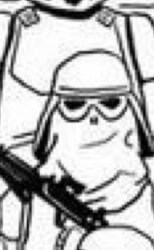

-1

In [31]:
import numpy as np
import argparse
import imutils
import cv2

image_path = "/content/hw2/MyDrive/package_for_python/IMAGE/Image_3/Image.jpg"
fragment_path = "/content/hw2/MyDrive/package_for_python/IMAGE/Image_3/fragment.jpg"

image = cv2.imread(image_path)
fragment = cv2.imread(fragment_path)

(fragmentHeight, fragmentWidth) = fragment.shape[:2]

result = cv2.matchTemplate(image, fragment, cv2.TM_CCOEFF)
(_, _, minLoc, maxLoc) = cv2.minMaxLoc(result)

topLeft = maxLoc
botRight = (topLeft[0] + fragmentWidth, topLeft[1] + fragmentHeight)
roi = image[topLeft[1]:botRight[1], topLeft[0]:botRight[0]]

mask = np.zeros(image.shape, dtype="uint8")
image = cv2.addWeighted(image, 0.20, mask, 0.75, 0)

image[topLeft[1]:botRight[1], topLeft[0]:botRight[0]] = roi

cv2_imshow(imutils.resize(image, height=950))
cv2_imshow(fragment)
cv2.waitKey(0)


In [31]:
|